# Project


In [1]:
from commonfunctions import *
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
from skimage.color import rgb2gray, rgba2rgb
from skimage.morphology import binary_erosion, binary_dilation, binary_closing,skeletonize, thin
from skimage.measure import find_contours
from skimage.draw import rectangle
from PIL import Image  
import PIL  
from skimage import exposure
import cv2
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
import os
import math
import heapq

# Show the figures / plots inside the notebook
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:

def getThreshold(Nimg):
    img=Nimg.copy()

    if len(img.shape)>2:
        img=rgb2gray(img)
    img = img / img.max()
    img = img* 255
    img = img.astype(np.uint8)
    pixels = 0
    counts = np.zeros(256)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            # print(img[i,j])
            counts[img[i,j]]+=1
            pixels += 1

    sum=0
    for i in range(len(counts)):
        sum+=counts[i]*i
    Tinit = round(sum/pixels)

    Tnew = Tinit
    while True:
        sum1 = 0
        sum2 = 0
        count1 = 0
        count2 = 0
        for i in range(len(counts)):
            if i < Tnew:
                sum1+=counts[i]*i
                count1+=counts[i]
            else:
                sum2+=counts[i]*i
                count2+=counts[i]
        if count1 == 0:
            count1 = 1
        if count2 == 0:
            count2 = 1
        Tnew = round((sum1/count1 + sum2/count2)/2)
        if Tnew == Tinit:
            break
        Tinit = Tnew    
    # Pixels with grey-level less than threshold will be equal to pure black and otherwise pixels will be equal to white (0 and 255 for unit8)
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            # print(img[i,j])
            if img[i,j] < Tnew :
                img[i,j] = 255
            else:
                img[i,j] = 0
    return img


def LocalThresholding(Nimg):
    img=Nimg.copy()
    if len(img.shape)>2:
        img=rgb2gray(img)
    quarter1 = img[0:img.shape[0]//2, 0:img.shape[1]//2]
    quarter2 = img[0:img.shape[0]//2, img.shape[1]//2:img.shape[1]]
    quarter3 = img[img.shape[0]//2:img.shape[0], 0:img.shape[1]//2]
    quarter4 = img[img.shape[0]//2:img.shape[0], img.shape[1]//2:img.shape[1]]
    quarter1 = getThreshold(quarter1)
    quarter2 = getThreshold(quarter2)
    quarter3 = getThreshold(quarter3)
    quarter4 = getThreshold(quarter4)
    img[0:img.shape[0]//2, 0:img.shape[1]//2] = quarter1
    img[0:img.shape[0]//2, img.shape[1]//2:img.shape[1]] = quarter2
    img[img.shape[0]//2:img.shape[0], 0:img.shape[1]//2] = quarter3
    img[img.shape[0]//2:img.shape[0], img.shape[1]//2:img.shape[1]] = quarter4
    return img


In [3]:


def Erode(img,windowSize):
    window=np.ones((windowSize,windowSize))
    Final=np.zeros(img.shape)
    for i in range(img.shape[0]-windowSize+1):
        for j in range(img.shape[1]-windowSize+1):
            Fit=np.all(np.logical_and(window,img[i:i+windowSize,j:j+windowSize]))
            Final[i,j]=Fit
    return Final

def Dilate(img,windowSize):
    window=np.ones((windowSize,windowSize))
    Final=np.zeros(img.shape)
    for i in range(img.shape[0]-windowSize+1):
        for j in range(img.shape[1]-windowSize+1):
            Hit=np.any(np.logical_and(window,img[i:i+windowSize,j:j+windowSize]))
            Final[i,j]=Hit
    return Final
def Gamma_correction(img,gamma):
    img = img / img.max()
    img = img* 255
    img = img.astype(np.uint8)
    img = exposure.adjust_gamma(img, gamma)
    return img



In [4]:
def houghTransform(img):
    orgimg=img.copy()
    cdst = orgimg.copy()
    cdstP = np.copy(cdst)
    
    lines = cv2.HoughLines(orgimg, 1, np.pi / 180, 150, None, 0, 0)
    
    if lines is not None:
        for i in range(0, len(lines)):
            rho = lines[i][0][0]
            theta = lines[i][0][1]
            a = math.cos(theta)
            b = math.sin(theta)
            x0 = a * rho
            y0 = b * rho
            pt1 = (int(x0 + 1000*(-b)), int(y0 + 1000*(a)))
            pt2 = (int(x0 - 1000*(-b)), int(y0 - 1000*(a)))
            cv2.line(cdst, pt1, pt2, (255,255,255), 2, cv2.LINE_AA)
    
    
    linesP = cv2.HoughLinesP(orgimg, 1, np.pi / 180, 50, None, 50, 60)
    
    if linesP is not None:
        for i in range(0, len(linesP)):
            l = linesP[i][0]
            cv2.line(cdstP, (l[0], l[1]), (l[2], l[3]), (255,255,255), 2, cv2.LINE_AA)
    
    return cdstP

In [5]:
def find_card(image_path):
    # Load the image
    image = cv2.imread(image_path)
    
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    grayPolygon = gray.copy()
    
    gray=Gamma_correction(gray,2.2)
        
    # Apply bilateralFilter to reduce noise and help contour detection
    blurred = cv2.bilateralFilter(gray, 80, 50, 5)
    blurred = cv2.GaussianBlur(blurred, (5, 5),0)

    # Apply adaptive mean thresholding to the blurred image
    
    # Use Canny edge detection
    edges = cv2.Canny(blurred, 40, 150)
    # To exit if number of iteraitons exceeds 5
    iterations = 0
    # To check if the card is detected
    rectangular_contours = []
    while (len(rectangular_contours) < 1):
        # dilation4 is the variable name that is used when finding contours
        if (iterations == 0):
            preProcessedImage = edges
        # If the card is not detected, apply Hough
        elif iterations == 1:
            preProcessedImage = cv2.dilate(preProcessedImage, np.ones((3,3)))
            preProcessedImage = cv2.erode(preProcessedImage, np.ones((3,3)))
        elif iterations == 2:
            preProcessedImage = houghTransform(preProcessedImage) 
        elif (iterations > 7):
            return image
        else:
            preProcessedImage = houghTransform(preProcessedImage) 
            # Apply opening and closing to the image to remove noise
            preProcessedImage = cv2.erode(preProcessedImage, np.ones((3,3)))
            preProcessedImage = cv2.dilate(preProcessedImage, np.ones((3,3)))
            preProcessedImage = cv2.dilate(preProcessedImage, np.ones((7,7)))
            preProcessedImage = cv2.erode(preProcessedImage, np.ones((7,7)))
        iterations += 1

        # Find contours
        contours, _ = cv2.findContours(preProcessedImage, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Filter contours based on area to find the card contour
        card_contour = None
        approx_polygon = None
        rectangular_contours = []
        max_area = 0
        for contour in contours:
            # Calculate the area of each contour
            area = cv2.contourArea(contour)
            if area > 30000:
                # Approximate the contour with a polygon
                peri = cv2.arcLength(contour, True)
                approx_polygon = cv2.approxPolyDP(contour, 0.015 * peri, True)
                # If the contour has 4 corners and its area is the maximum so far, then it is the card contour
                if area > max_area and len(approx_polygon) == 4:
                    cv2.polylines(grayPolygon, [approx_polygon], isClosed=True, color=(0, 255, 0), thickness=5)
                    card_contour = approx_polygon
                    max_area = area
                    rectangular_contours.append(approx_polygon)
        
    # Get the coordinates of the polygon's vertices (corners)
    corners = np.squeeze(card_contour)
    if (corners.any() == None):
        return image
    if (len(corners) != 4):
        return image
    
    # Pixel values in the original image
    points = card_contour.reshape(4, 2)
    input_points = np.zeros((4, 2), dtype="float32")

    topY = np.argmin(corners[:, 1])
    bottomY = np.argmax(corners[:, 1])
    rightX = np.argmax(corners[:, 0])
    leftX = np.argmin(corners[:, 0])
    
    caseNum = 0
    
    points_sum = points.sum(axis=1)
    input_points[0] = points[np.argmin(points_sum)]
    input_points[3] = points[np.argmax(points_sum)]

    points_diff = np.diff(points, axis=1)
    input_points[1] = points[np.argmin(points_diff)]
    input_points[2] = points[np.argmax(points_diff)]

    (top_left, top_right, bottom_left, bottom_right) = input_points
    bottom_width = np.sqrt(((bottom_right[0] - bottom_left[0]) ** 2) + ((bottom_right[1] - bottom_left[1]) ** 2))
    top_width = np.sqrt(((top_right[0] - top_left[0]) ** 2) + ((top_right[1] - top_left[1]) ** 2))
    right_height = np.sqrt(((top_right[0] - bottom_right[0]) ** 2) + ((top_right[1] - bottom_right[1]) ** 2))
    left_height = np.sqrt(((top_left[0] - bottom_left[0]) ** 2) + ((top_left[1] - bottom_left[1]) ** 2))
    
    if(max(top_width, bottom_width) < max(right_height, left_height)):
        if corners[rightX][1] < corners[leftX][1]: #clockwise
            temp = input_points[0].copy()
            input_points[0] = input_points[2]
            input_points[2] = input_points[3]
            input_points[3] = input_points[1]
            input_points[1] = temp
        else:   #counter clockwise
            temp = input_points[0].copy()
            input_points[0] = input_points[1]
            input_points[1] = input_points[3]
            input_points[3] = input_points[2]
            input_points[2] = temp

    # Output image size
    max_width = 1024

    max_height = 650  

    # Desired points values in the output image
    converted_points = np.float32([[0, 0], [max_width, 0], [0, max_height], [max_width, max_height]])

    # Perspective transformation
    matrix = cv2.getPerspectiveTransform(input_points, converted_points)
    img_output = cv2.warpPerspective(image, matrix, (max_width, max_height))
    
    # Draw the polygon on the original image
    image_with_polygon = image.copy()
    cv2.polylines(image_with_polygon, [approx_polygon], isClosed=True, color=(0, 255, 0), thickness=2)

    show_images([image, img_output], ["Original image", "Output image"])
    
    return img_output

In [6]:

def showKarneh(Orginalimg):

    Orgimg=cv2.cvtColor(Orginalimg,cv2.COLOR_BGR2GRAY)
    Orgimg=cv2.resize(Orgimg,(1024,650))
    if (Orgimg.max()<100):
        Orgimg=Gamma_correction(Orgimg,0.5)
    elif (Orgimg.min()>200):
        Orgimg=Gamma_correction(Orgimg,1.5)
    Eimg = Orgimg[int((1.9/5.35)*Orgimg.shape[0]):int((3.8/5.35)*Orgimg.shape[0]),int(Orgimg.shape[1]*0.365):Orgimg.shape[1]]
    
    Eimg=cv2.adaptiveThreshold(Eimg,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY_INV,81,31)

    dilated1=binary_dilation(Eimg.copy(),np.ones((3,3)))
    Dilated=binary_dilation(dilated1,np.ones((1,42)))
    negative_img = np.ones(Dilated.shape) - Dilated

    Closed=binary_erosion(Dilated,np.ones((1,30)))
    Contours=find_contours(Closed,0.8)
    name_image = Eimg.copy()
    code_image = Eimg.copy()
    max=0
    i=-1
    code_index=23453420938465053
    name_image = Eimg.copy()
    for contour in Contours:
        i+=1
        maxY=contour[:,0].max()
        maxX=contour[:,1].max()
        minY=contour[:,0].min()
        minX=contour[:,1].min()
        if ((maxY-minY)/Closed.shape[0]>0.17): ###################################################################################
            if (6<=((maxX-minX)/(maxY-minY))<=9):     #Name
                if i<code_index:
                    name_image = Eimg.copy()
                    if maxX-minX>max:
                        name_image=name_image[int(minY):int(maxY),int(minX):int(maxX)]
                        max=maxX-minX

            if (4<=((maxX-minX)/(maxY-minY))<=6):       #code
                code_image=code_image[int(minY):int(maxY),int(minX):int(maxX)]
                code_index=i
    name_image=binary_closing(name_image,np.ones((3,2)))
    code_image=binary_closing(code_image,np.ones((3,2)))
    name_image=255-name_image
    code_image=255-code_image
    show_images([Orginalimg,name_image,code_image])
    output=[]
    output.append(name_image)
    output.append(code_image)
    return output    



In [215]:
# out_image='out.jpg'
# results=arabicocr.arabic_ocr("1code.jpg",out_image)
# print(results)
# words=[]
# for i in range(len(results)):	
# 		word=results[i][1]
# 		for x in word:
# 			if 'قمر'==x or 'كمر' == x:
# 				x='محمد'
# 		words.append(word)
# with open ('file.txt','w',encoding='utf-8')as myfile:
# 		myfile.write(str(words))
# import cv2
# img = cv2.imread('out.jpg', cv2.IMREAD_UNCHANGED)
# cv2.imshow("arabic ocr",img)
# cv2.waitKey(0)

In [7]:

def getWords(path):
    path=path.astype(np.uint8)
    if(len(path.shape)==3):
        if(path.shape[2]==4):
            path=rgba2rgb(path)
        path = rgb2gray(path)
    path=cv2.resize(path,(600,90))
    path = path > 254.5
    path=path*255
    path=255-path
    pathD=binary_dilation(path,np.ones((7,11)))
    contours=find_contours(pathD,0.7)
    bounding_boxes=[]
    queue=[]
    for contour in contours:
        img=np.copy(path)
        maxY=contour[:,0].max()
        maxX=contour[:,1].max()
        minY=contour[:,0].min()
        minX=contour[:,1].min()

        if maxX-minX>70: ###################################################################################
            heapq.heappush(queue, (-maxX,path[:,int(minX):int(maxX)]))                                                      
            img=path[:,int(minX):int(maxX)]
    return queue


In [8]:
def getCharacters(path):
    path=path>0.5
    pathD=binary_dilation(path,np.ones((15,1)))
    pathD=binary_erosion(pathD,np.ones((28,1)))
    pathD=binary_dilation(pathD,np.ones((1,6)))

    contours=find_contours(pathD,0.7)
    bounding_boxes=[]
    queue=[]
    for contour in contours:
        img=np.copy(path)
        maxY=contour[:,0].max()
        maxX=contour[:,1].max()
        minY=contour[:,0].min()
        minX=contour[:,1].min()
        if maxX-minX>10: ###################################################################################
            heapq.heappush(queue, (-maxX,path[:,int(minX):int(maxX)]))                                                      
            img=path[:,int(minX):int(maxX)]
          
    letters=[]
    while (len(queue)>0):
        img=heapq.heappop(queue)[1]
        img=img.astype(np.uint8)
        img=img.max()-img
        letters.append(img)
    return letters

In [9]:

dataset_path = 'letters'
letters_data = []
labels = []
minHeight = math.inf
minWidth =  math.inf
for letter_folder in os.listdir(dataset_path):
    letter_path = os.path.join(dataset_path, letter_folder)
    if os.path.isdir(letter_path):
        for filename in os.listdir(letter_path):
            if filename.endswith('.png'):  
                image_path = os.path.join(letter_path, filename)
                img = io.imread(image_path)
                if(img.shape[0] < minHeight):
                    minHeight = img.shape[0]
                if(img.shape[1] < minWidth):
                    minWidth = img.shape[1]
                

new_dimensions = (minWidth, minHeight)
for letter_folder in os.listdir(dataset_path):
    letter_path = os.path.join(dataset_path, letter_folder)
    if os.path.isdir(letter_path):
        for filename in os.listdir(letter_path):
            if filename.endswith('.png'):  
                image_path = os.path.join(letter_path, filename)
                original_image = io.imread(image_path)
                img = cv2.resize(original_image, new_dimensions)
                if(img.shape[2]==4):
                    img=rgba2rgb(img)
                img = rgb2gray(img)
                flattened_image = img.flatten()
                letters_data.append(flattened_image)
                labels.append(letter_folder)  # Use the folder name as the label

# Convert the lists to numpy arrays
X = np.array(letters_data)
y = np.array(labels)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.01, random_state=0)

# Initialize the KNN classifier
knn_classifier = KNeighborsClassifier(n_neighbors=3) 

# Train the classifier
knn_classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = knn_classifier.predict(X_test)
# print(y_pred)

# Evaluate the accuracy of the classifier
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy * 100:.2f}%")

Accuracy: 75.00%


In [10]:
def translateName(images):
    test=[]
    for image in images:
        image = cv2.resize(image, new_dimensions)
        if(len(image.shape)==3):
            if(image.shape[2]==4):
                image=rgba2rgb(image)
            image = rgb2gray(image)
        image = image > 0.2         
        ############################################### printing chars 
        # io.imshow(image)            
        # io.show()
        flattened_image = image.flatten()
        test.append(flattened_image)
    output = knn_classifier.predict(test)
    word = ''
    for letter in output:
        word += letter
    print(word)

In [11]:
def getNumbers(img):
    img = img.astype(np.uint8)
    if(len(img.shape)==3):
        if(img.shape[2]==4):
            img=rgba2rgb(img)
        img = rgb2gray(img)
    img = img > 254.5
    contours=find_contours(img,0.7)
    queue=[]
    for contour in contours:
        image=np.copy(path)
        maxY=contour[:,0].max()
        maxX=contour[:,1].max()
        minY=contour[:,0].min()
        minX=contour[:,1].min()

        if maxX-minX>10: ###################################################################################
            heapq.heappush(queue, (minX,img[:,int(minX):int(maxX)]))                                                      
            image=img[:,int(minX):int(maxX)]
           
    # print(queue)
    letters=[]
    while (len(queue)>0):
        img=heapq.heappop(queue)[1]
        img=img.astype(np.uint8)
        img=img.max()-img
        letters.append(img)
    return letters
    

In [12]:

dataset_path1 = 'Numbers'
letters_data1 = []
labels1 = []
minHeight1 = math.inf
minWidth1 =  math.inf
for letter_folder1 in os.listdir(dataset_path1):
    letter_path1 = os.path.join(dataset_path1, letter_folder1)
    if os.path.isdir(letter_path1):
        for filename in os.listdir(letter_path1):
            if filename.endswith('.png'):  
                image_path = os.path.join(letter_path1, filename)
                img = io.imread(image_path)
                if(img.shape[0] < minHeight1):
                    minHeight1 = img.shape[0]
                if(img.shape[1] < minWidth1):
                    minWidth1 = img.shape[1]
                

new_dimensions1 = (minWidth1, minHeight1)
for letter_folder1 in os.listdir(dataset_path1):
    letter_path1 = os.path.join(dataset_path1, letter_folder1)
    if os.path.isdir(letter_path1):
        for filename in os.listdir(letter_path1):
            if filename.endswith('.png'):  
                image_path1 = os.path.join(letter_path1, filename)
                original_image1 = io.imread(image_path1)
                img1 = cv2.resize(original_image1, new_dimensions1)
                if(img1.shape[2]==4):
                    img1=rgba2rgb(img1)
                img1 = rgb2gray(img1)
                flattened_image1 = img1.flatten()
                letters_data1.append(flattened_image1)
                labels1.append(letter_folder1)  # Use the folder name as the label

# Convert the lists to numpy arrays
X1 = np.array(letters_data1)
y1 = np.array(labels1)
# print(y1)

# Split the dataset into training and testing sets
X_train1, X_test1, y_train1, y_test1 = train_test_split(X1, y1, test_size=0.01, random_state=0)

# Initialize the KNN classifier
knn_classifier1 = KNeighborsClassifier(n_neighbors=3) 

# Train the classifier
knn_classifier1.fit(X_train1, y_train1)

# Make predictions on the test set
y_pred1 = knn_classifier1.predict(X_test1)
# print(y_pred)

# Evaluate the accuracy of the classifier
accuracy = accuracy_score(y_test1, y_pred1)
print(f"Accuracy: {accuracy * 100:.2f}%")

Accuracy: 100.00%


In [13]:
def translateNumber(images):
    test1=[]
    for image in images:
        image=image.astype(np.uint8)
        image = cv2.resize(image, new_dimensions1)
        if(len(image.shape)==3):
            if(image.shape[2]==4):
                image=rgba2rgb(image)
            image = rgb2gray(image)
        image = image < 0.2
        flattened_image = image.flatten()
        test1.append(flattened_image)
    output = knn_classifier1.predict(test1)
    word = ''
    for letter in output:
        word += letter
    print("code: " + word)

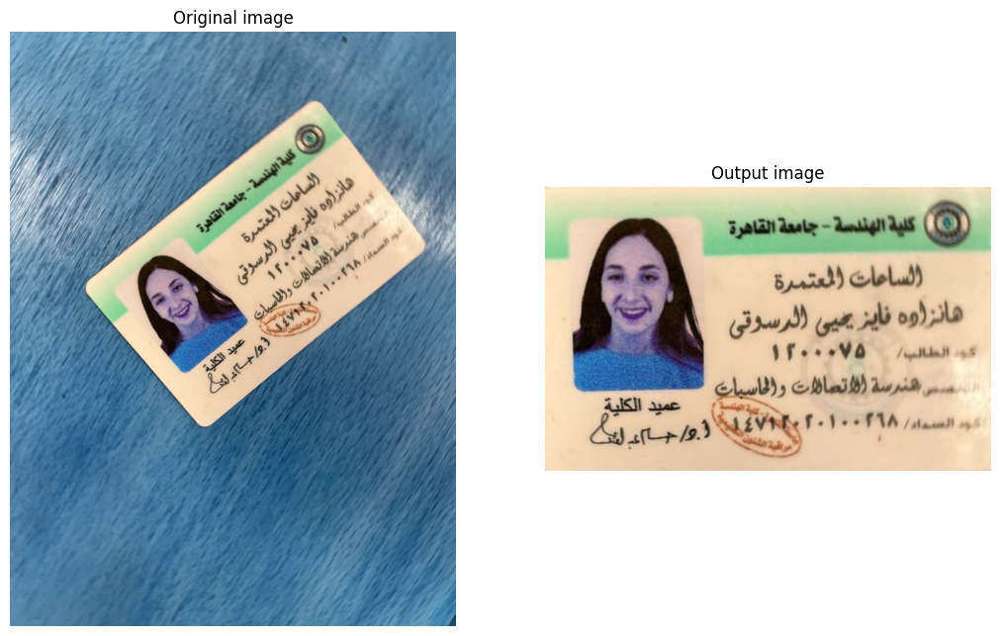

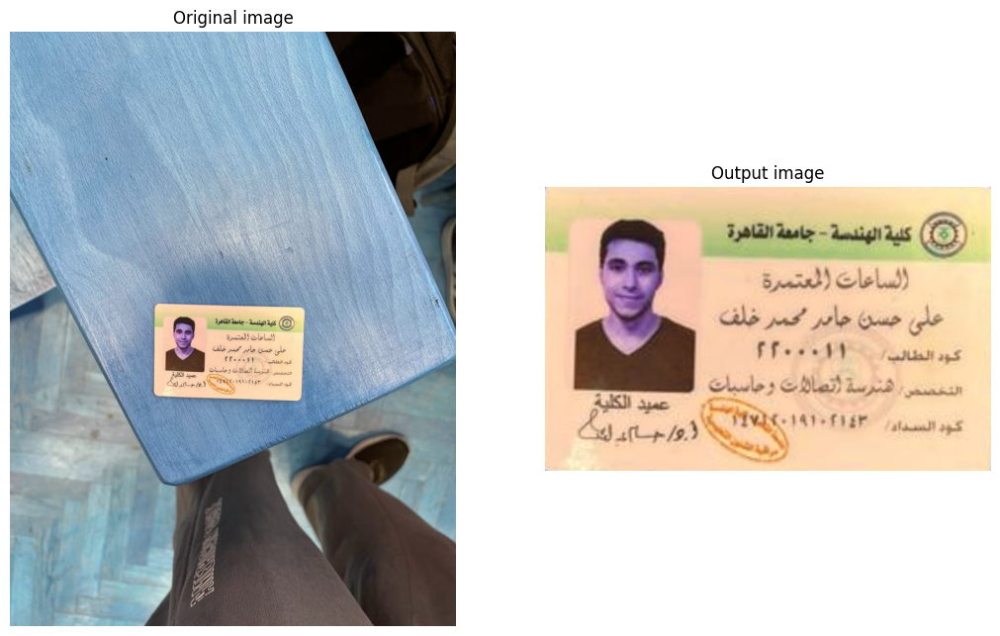

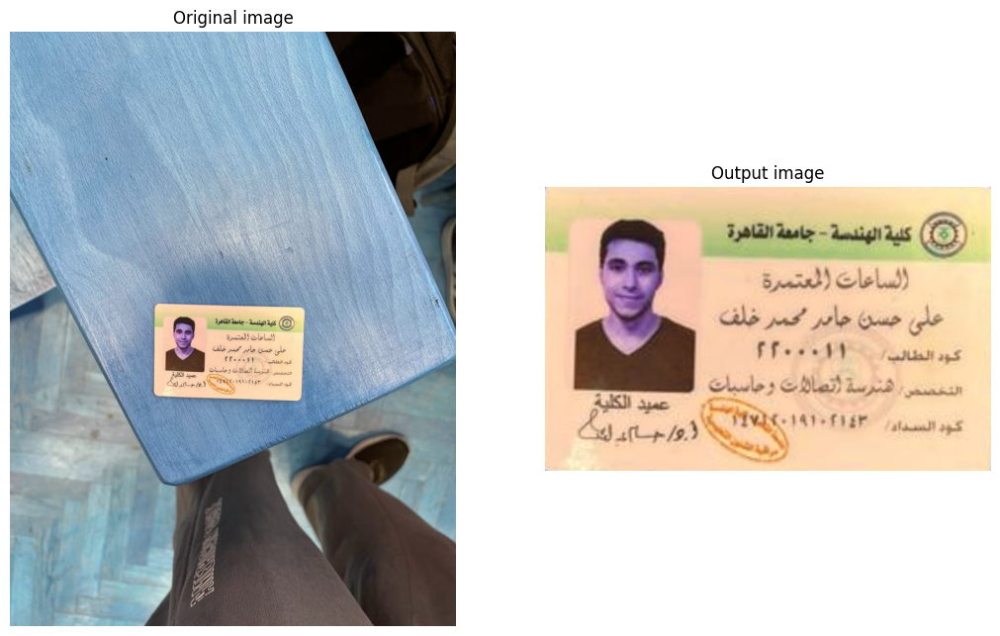

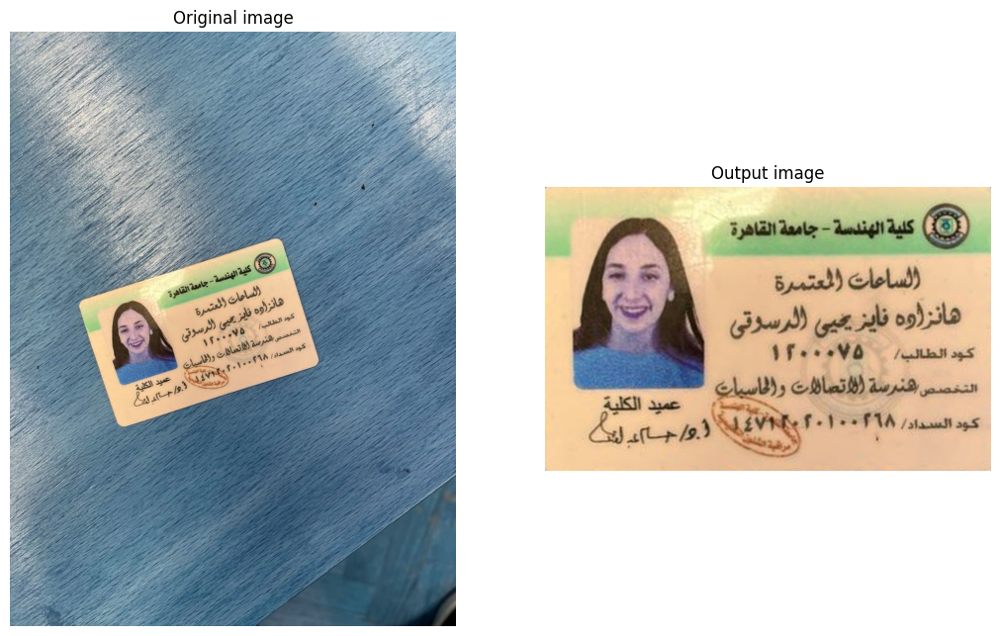

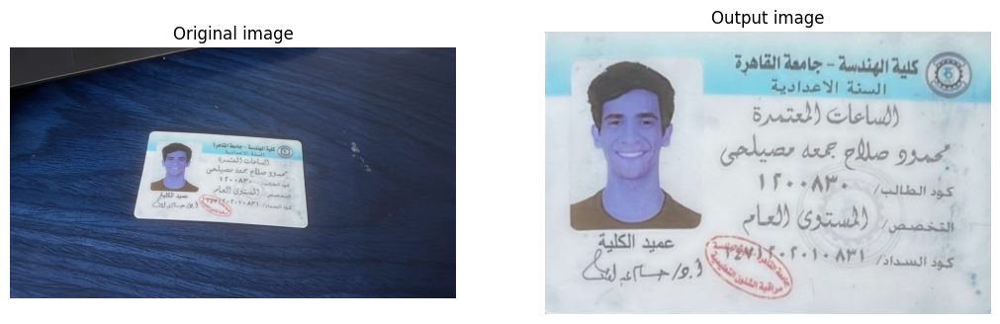

...

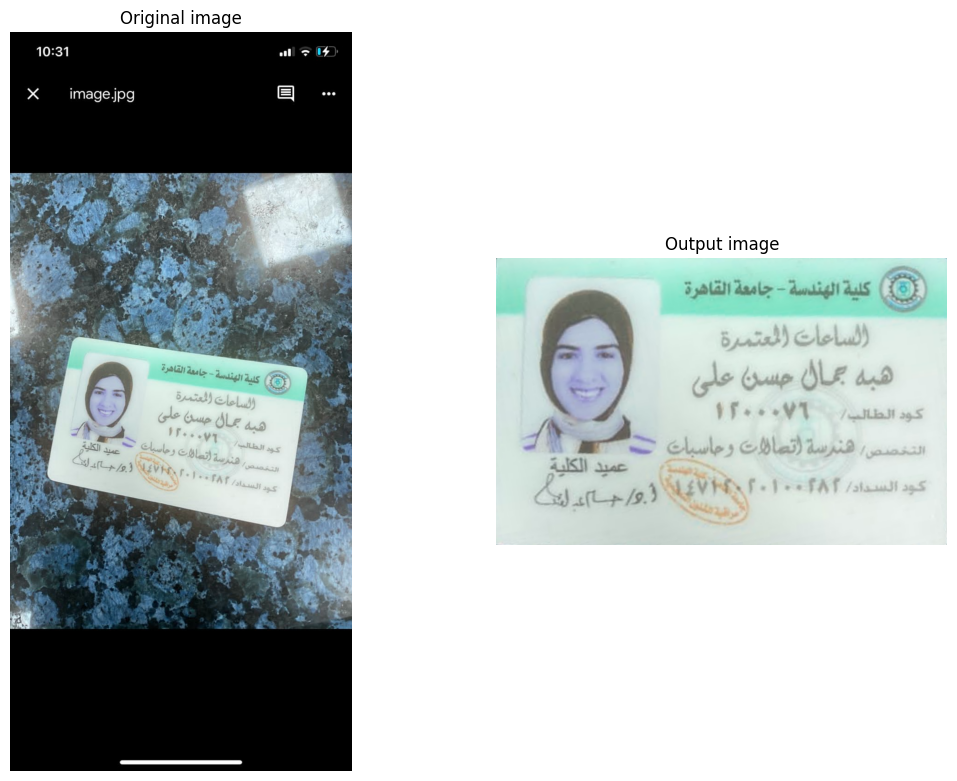

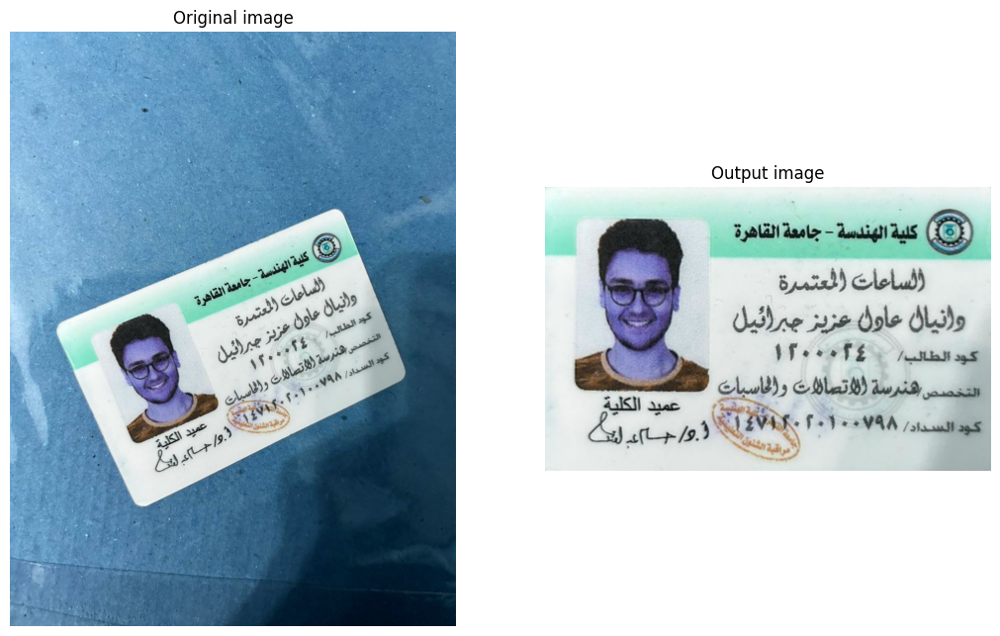

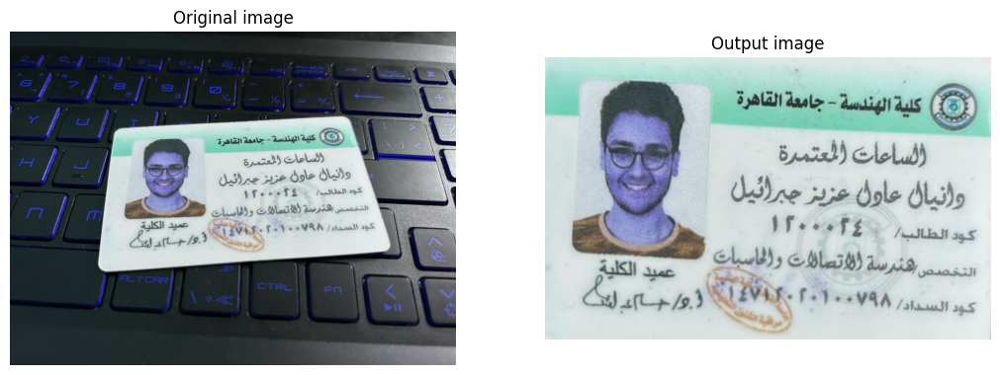

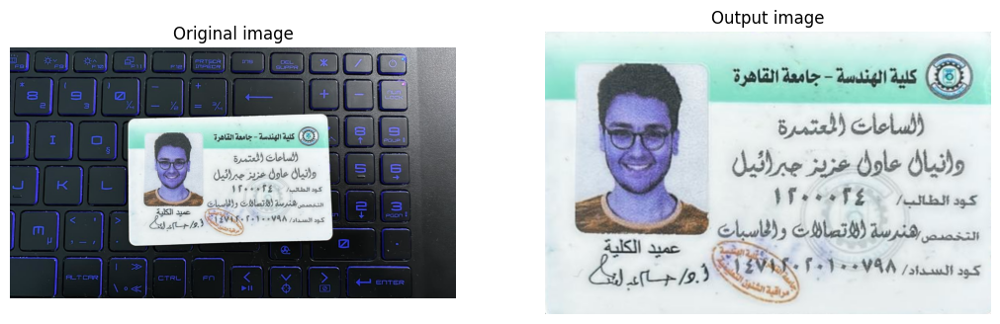

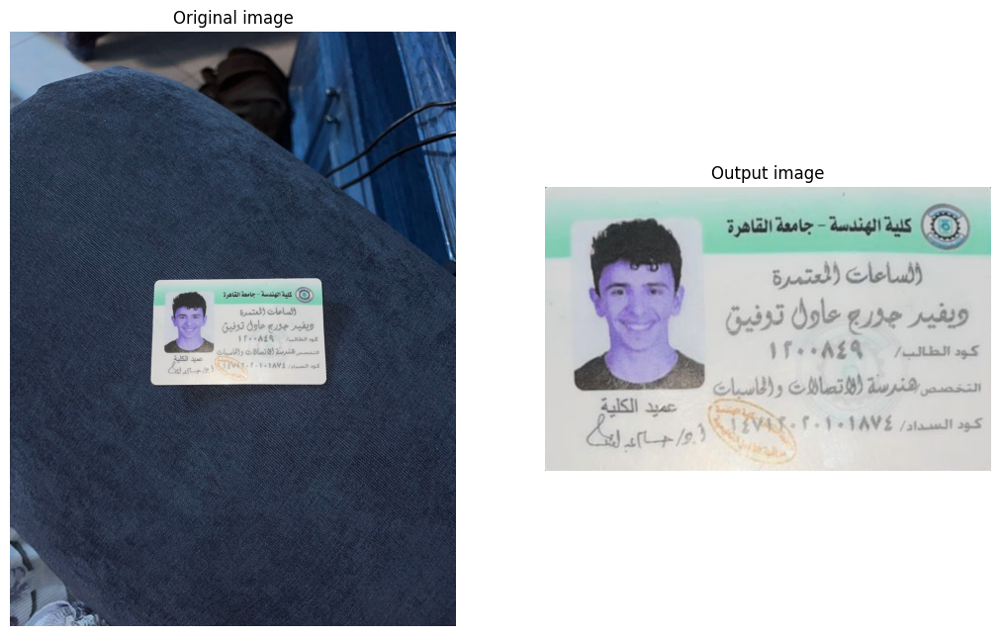

In [223]:
# find card
for i in range(1,55):
    path="./Test/"+str(i)+".jpeg"
    find_card(path)
   


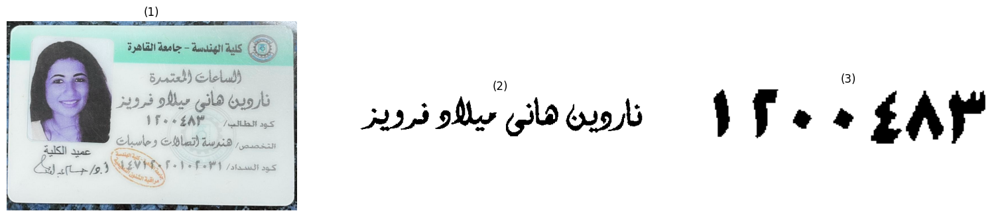

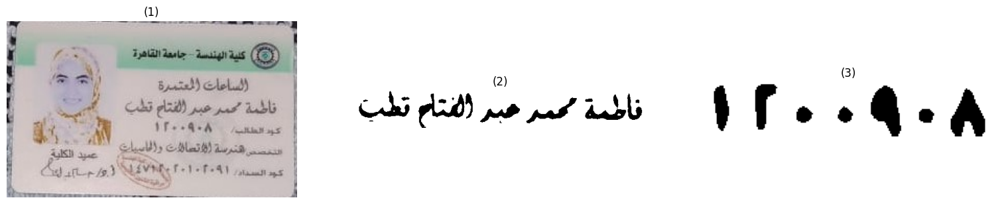

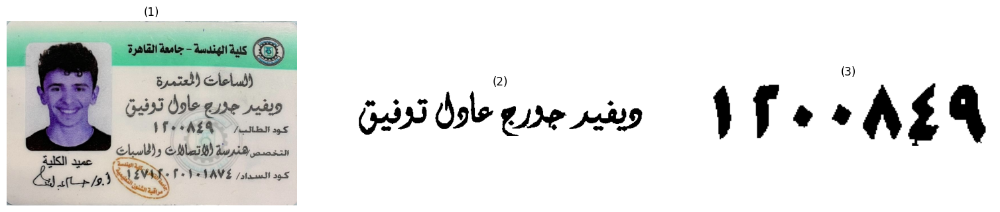

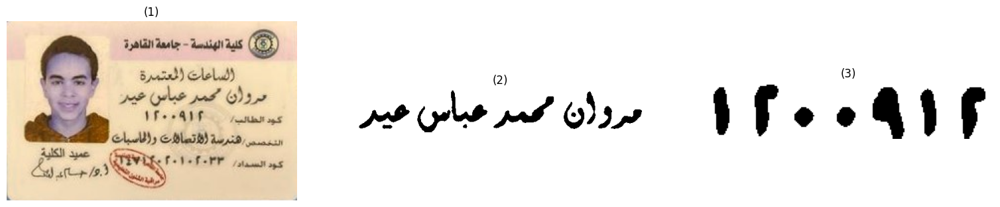

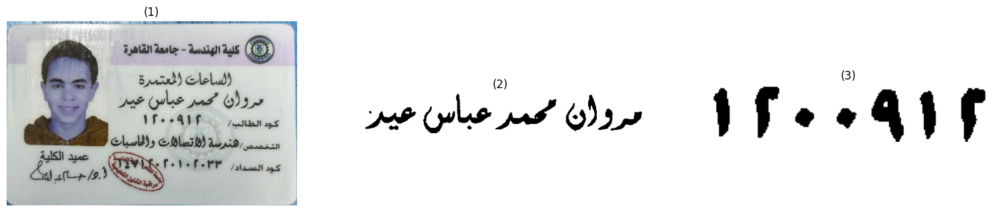

...

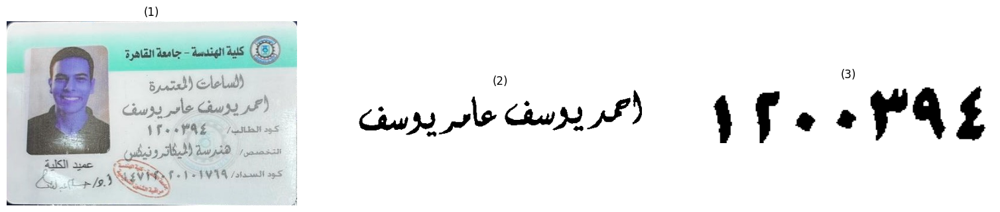

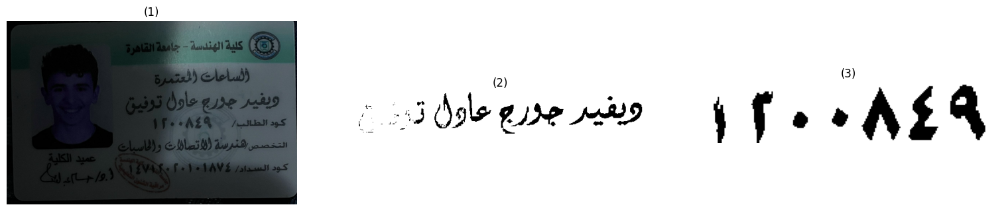

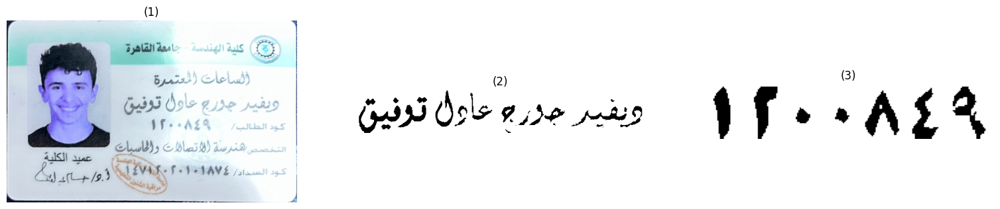

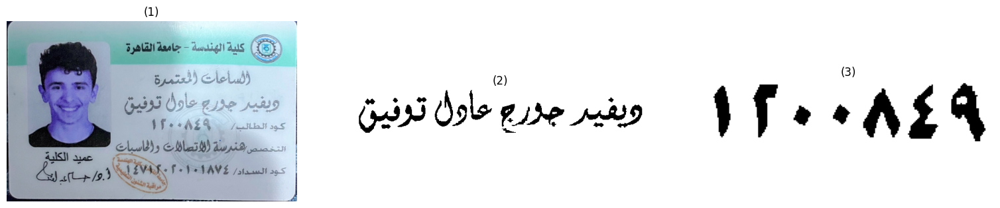

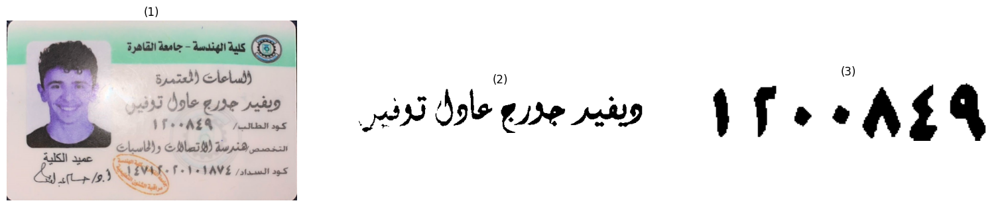

c:\Users\donyh\Desktop\uni\semester5\Image\zeft\Project\commonfunctions.py:42: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  plt.imshow(image)


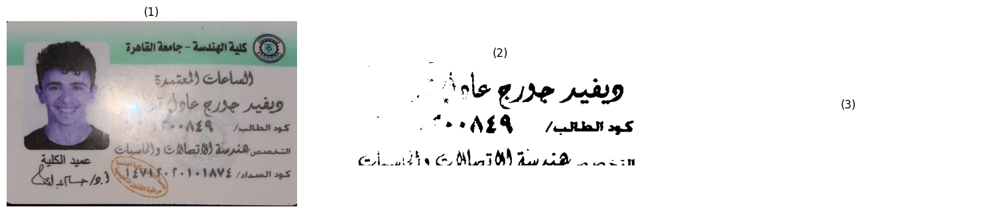

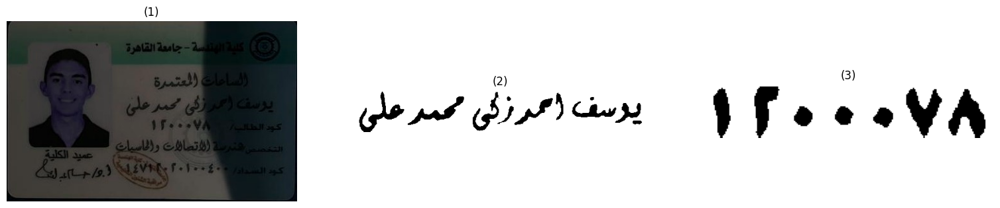

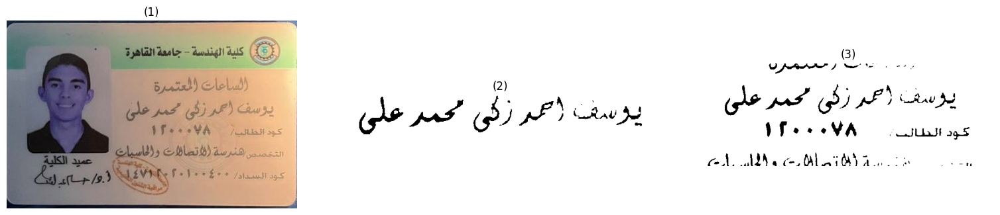

In [224]:
# ready
for i in range(1,23):
    path="./Ready/"+str(i)+".jpeg"
    path=cv2.imread(path)
    showKarneh(path)

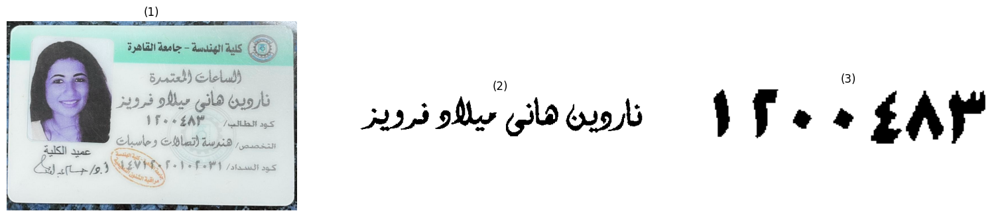

نارديون
حهي
ميلاد
فويز
code: 1200483


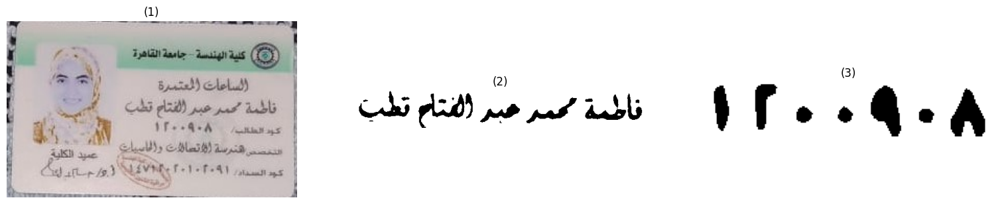

فاطمه
محمد
عبد
حج
قطبم
code: 1200108


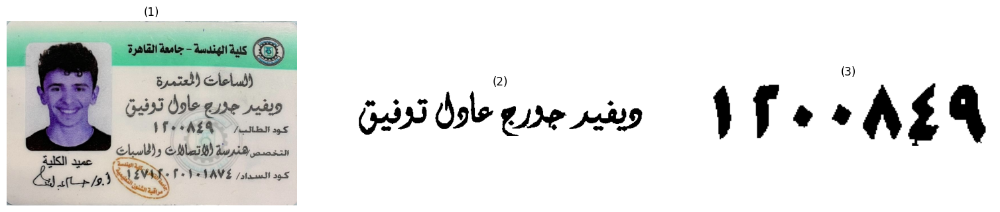

دسيد
جورج
عادلم
توفيق
code: 1200849


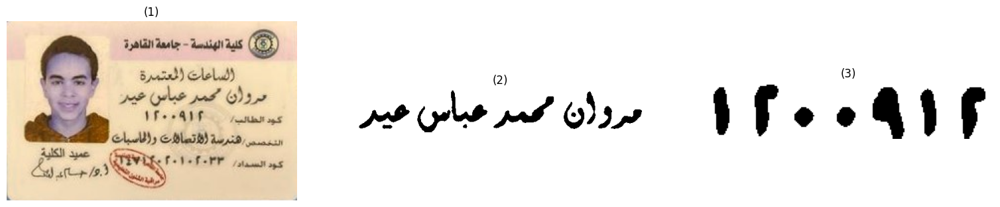

رو
ان
محد
عباس
سق
حد
code: 1200912


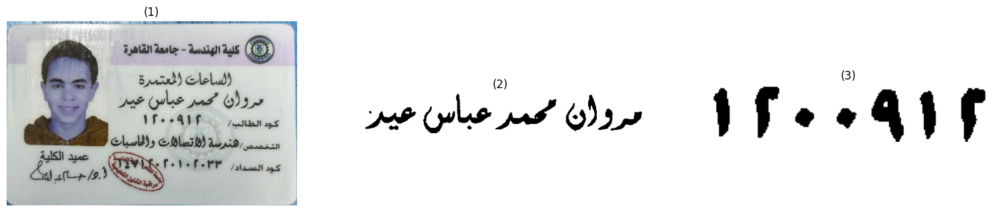

دررر
انم
محمد
عباس
حد
code: 1200912


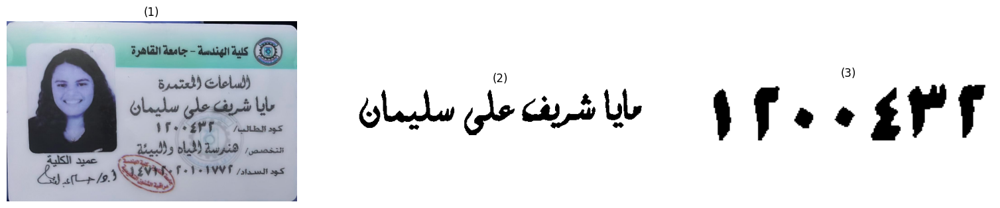

مجا
شريفم
علي
سليمان
code: 1200432


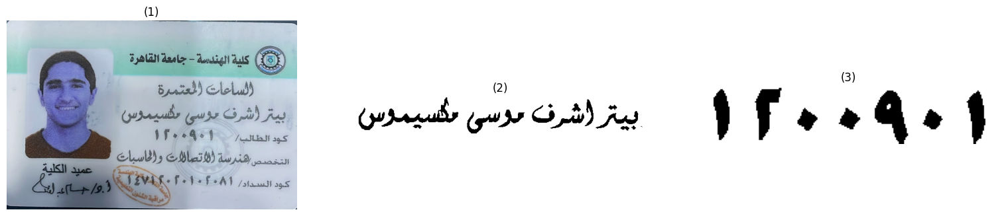

ست
اشف
موسي
مهيموسور
code: 1200901


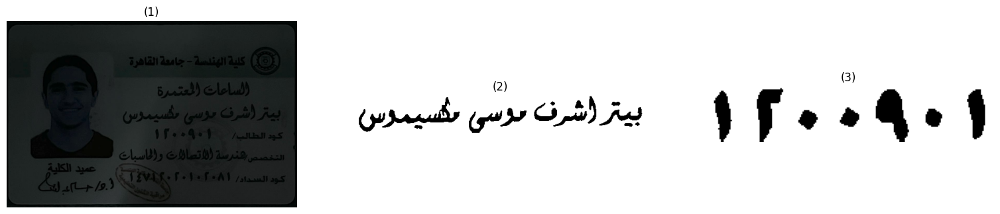

بتر
اشف
موسي
مهيموسقر
code: 1200901


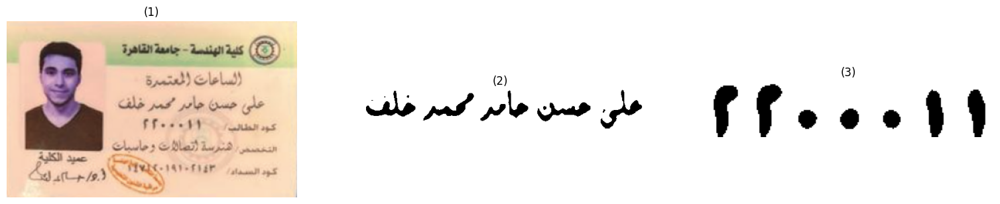

سن
سمد
محمبد
دلفم
code: 2200011


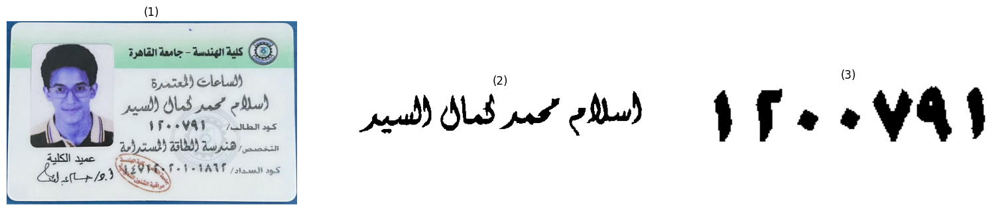

اسطم
سطمد
محمد
وماام
السبد
code: 1200791


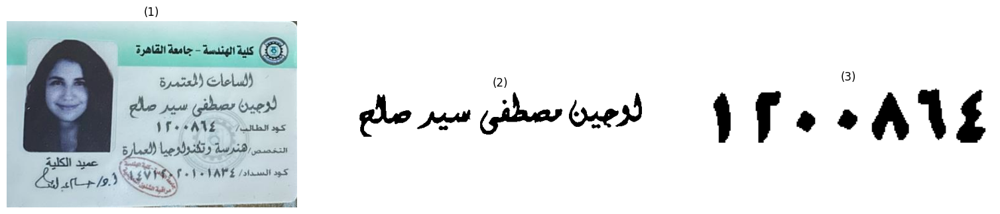

لوجيون
مصطفي
سميد
صلح
code: 1200864


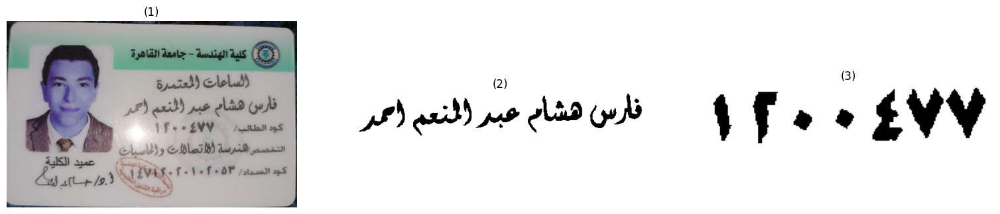

فدموم
هشامب
عبد
النصد
احد
code: 1200477


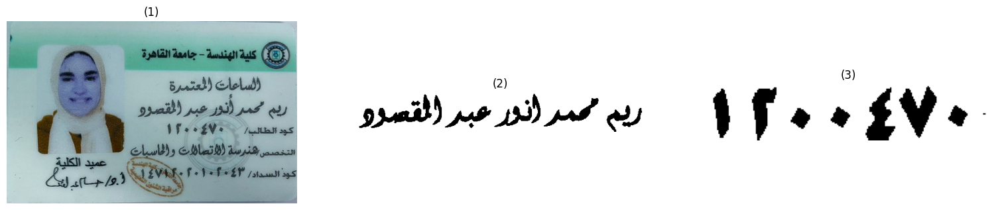

رس
محمد
انور
عبد
القصود
code: 1200470


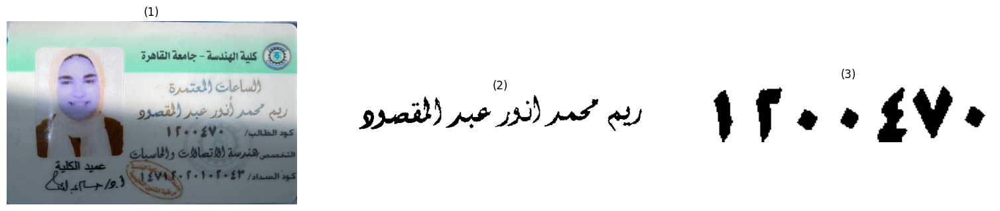

يمس
محمد
او
عبد
القصود
code: 1200470


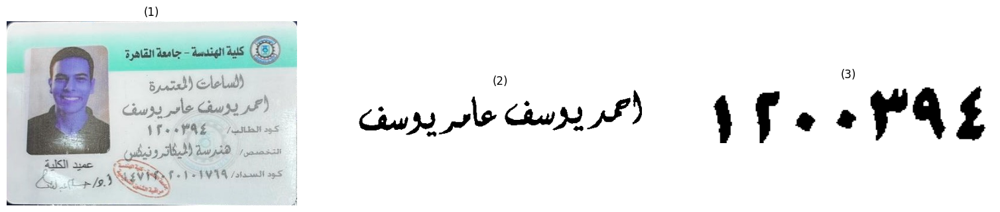

احديوسقم
دادردددر
code: 1200394


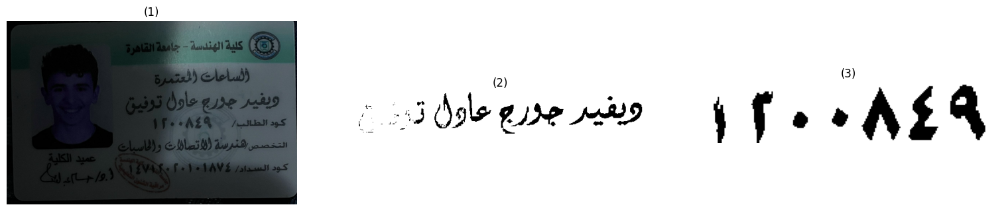

ديفيد
جوجح
عادوم
code: 200849


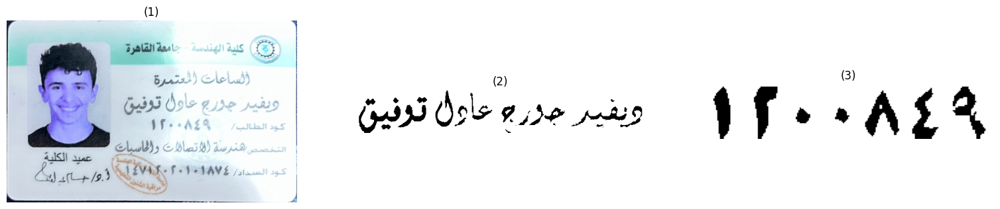

دييفي
جوج
علس
توفيق
code: 1200849


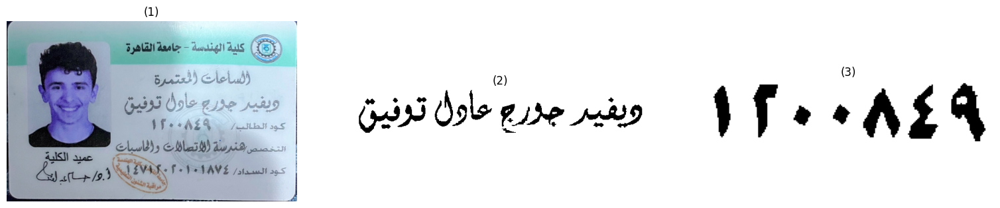

ديفيد
جوجج
عادلس
توفيقر
code: 1200849


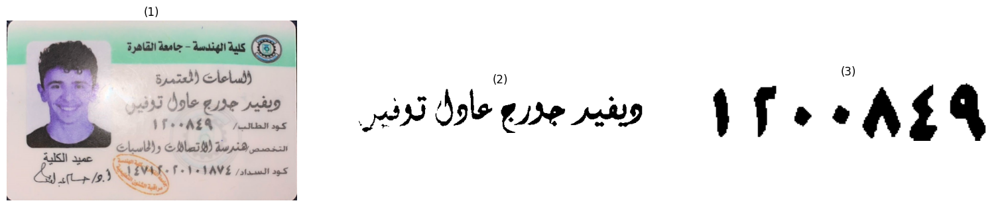

ديفيد
جورج
عادل
تير
code: 1200849


In [228]:
# ready + svm

for i in range(1,20):
    path="./Ready/" +str(i)+ ".jpeg"
    path=cv2.imread(path)
    data=[]
    data=showKarneh(path)
    queue=getWords(data[0])
    while(len(queue)>0):
        img=heapq.heappop(queue)[1]
        queue2=getCharacters(img)
        translateName(queue2)
    numbers=getNumbers(data[1])
    translateNumber(numbers)   


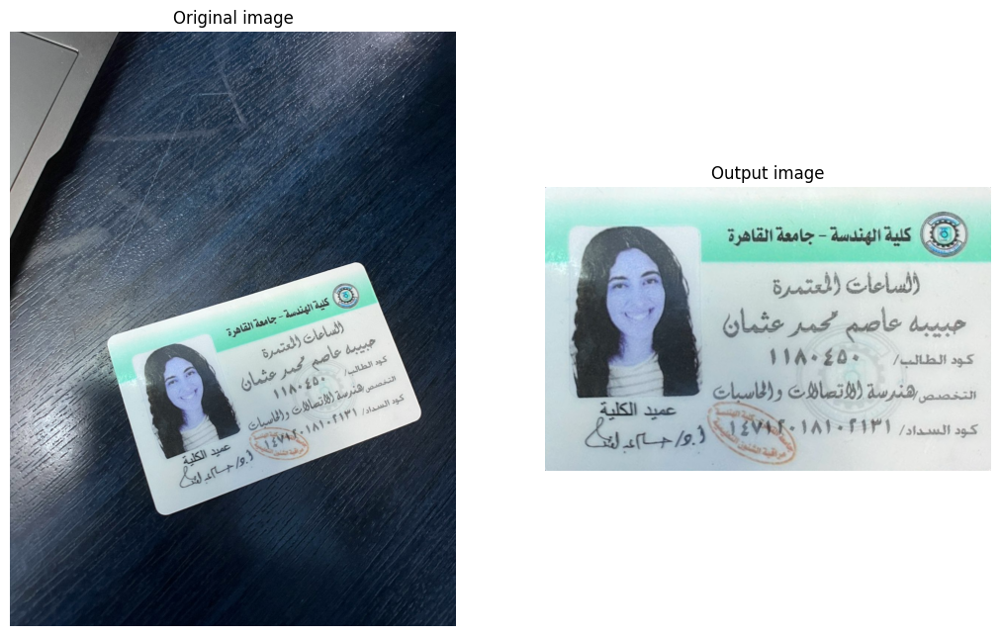

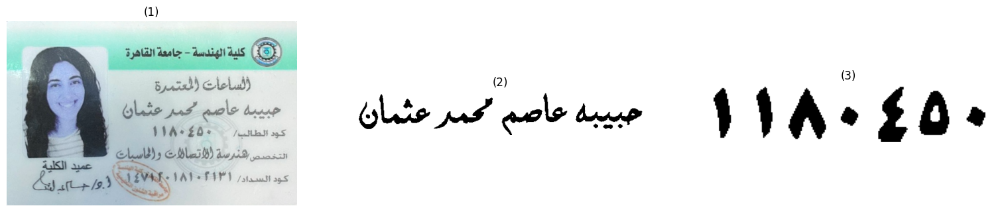

جبيبه
عاصم
صمب
محمد
علمانم
code: 1180440


In [18]:
#  kolo
for i in range(2,3):
    path="./integrated/"+str(i)+".jpeg"
    data = showKarneh(find_card(path))
    queue=getWords(data[0])
    while(len(queue)>0):
        img=heapq.heappop(queue)[1]
        queue2=getCharacters(img)
        translateName(queue2)
    numbers=getNumbers(data[1])
    translateNumber(numbers)  